## Paycheck Protection Program Exploratory Data Analysis


The federal government just [released some details about the paycheck protection program loans](https://home.treasury.gov/policy-issues/cares-act/assistance-for-small-businesses/sba-paycheck-protection-program-loan-level-data). The full dataset has about 600k rows and CO was around the 100k mark so it's medium sized but well within what my local machine can handle.

With that, I took a few hours to do some EDA on loans in Colorado!

Let's answer:
* What does the balance of large to small loans look like in CO?
* Who is getting the largest loans?
* Who is getting the smallest loans?
* What do loan amounts look like when broken out by type of business?
* Whats the balance of loan awards between nonprofits and for-profit businesses?
* What does the distribution of staff size look like as a whole and when broken out by industry?
* Are there any companies that at first glance, look so large that they don't fit within the spirit of the loan program?


Caveats! They always exist. Some of this data is rumored to be faulty. For example, some people claim they show up in the database but did not apply for, or receive, funds under this program. See [this article](http://mail01.tinyletterapp.com/data-is-plural/data-is-plural-2020-07-08-edition/17448558-www.cnbc.com/2020/07/06/ppp-small-business-coroniavirus-loan-database-contains-errors.html?c=edd6cfc9-960d-4b6c-a66f-c72077ac5ae2) for discussion.

### Geocoding

Geocoding is the process of matching a location on the earth's surface from a label of a place like an address. In this case, I geocoded all 13,385 loans in Colorado. It may not be the world's fastest method at ~3 requests/second, but it is completely free.  What's that phrase...Ah, right: *It's good enough for government work*

In [1]:
import pandas as pd
import missingno as msno
import numpy as np
import folium
from folium.plugins import MarkerCluster
import matplotlib.pyplot as plt
import seaborn as sns
from folium.features import DivIcon

from matplotlib import rcParams
rcParams.update({'figure.autolayout': True})

### Data Import

In [2]:
loans = pd.read_csv(
    '../data/interim/co_loans_geocoded.csv',
    skip_blank_lines=True,
)

print('Dataframe size in memory: {s} MB.'.format(
    s=loans.memory_usage(index=True, deep=True).sum() / 1000000))

Dataframe size in memory: 18.968016 MB.


In [3]:
small_loans = pd.read_csv(
    '../data/raw/PPP Data up to 150k - CO.csv',
    skip_blank_lines=True,
)

print('Dataframe size in memory: {s} MB.'.format(
    s=small_loans.memory_usage(index=True, deep=True).sum() / 1000000))

Dataframe size in memory: 61.803152 MB.


### Data Integrity Checks
 

#### Checking for missing data

In [4]:
## How much of the data is missing per field?

#calculated

# sum of null or na across dataframe
pct_missing = ((loans.isnull() | loans.isna()).sum() * 100 /
               loans.index.size).round(2)

#creating df with results
missing_df = pd.DataFrame({
    'column_name': loans.columns,
    'percent_missing': pct_missing
})
#descending sort
missing_df.sort_values('percent_missing', inplace=True, ascending=False)

missing_df

,column_name,percent_missing
NonProfit,NonProfit,93.01
JobsRetained,JobsRetained,7.84
NAICSCode,NAICSCode,0.84
Google Maps Link,Google Maps Link,0.71
BusinessType,BusinessType,0.19
Address,Address,0.01
State,State,0.00
Lender,Lender,0.00
loc_geocoded,loc_geocoded,0.00
geocoding_confidence,geocoding_confidence,0.00


C:\Anaconda3\envs\ppp\lib\site-packages\IPython\core\pylabtools.py:132: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  fig.canvas.print_figure(bytes_io, **kw)


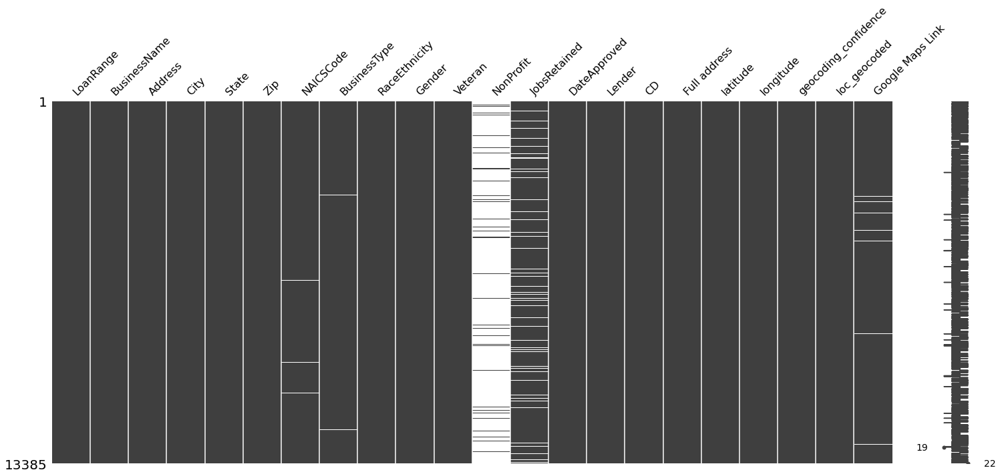

In [5]:
#visualized using missingno
msno.matrix(loans)

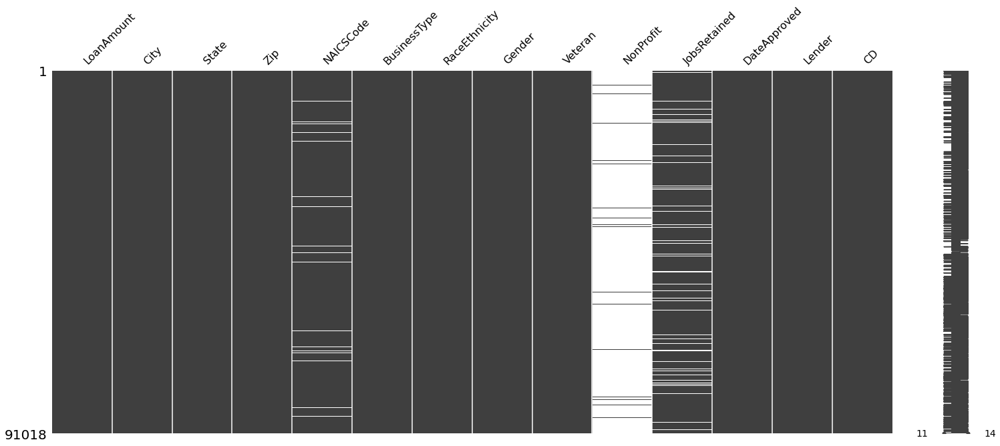

In [6]:
msno.matrix(small_loans)

#### Other quick cleaning

In [7]:
loans.dtypes

LoanRange                object
BusinessName             object
Address                  object
City                     object
State                    object
Zip                       int64
NAICSCode               float64
BusinessType             object
RaceEthnicity            object
Gender                   object
Veteran                  object
NonProfit                object
JobsRetained            float64
DateApproved             object
Lender                   object
CD                       object
Full address             object
latitude                 object
longitude                object
geocoding_confidence     object
loc_geocoded             object
Google Maps Link         object
dtype: object

In [8]:
#replacing null placeholder strings
for col in ['RaceEthnicity', 'Gender', 'Veteran']:
    loans[col] = loans[col].replace({'Unanswered': np.nan})

In [9]:
#drop any records where geocoding was unsuccessful
loans = loans[loans['longitude'] != 'not found']

In [10]:
#replacing null placeholder strings
for col in ['RaceEthnicity', 'Gender', 'Veteran']:
    small_loans[col] = small_loans[col].replace({'Unanswered': np.nan})

In [11]:
#fill nan business types
small_loans['BusinessType'] = small_loans.BusinessType.fillna('unknown')

#calculate loan amount per job retained
small_loans['dollar_per_job'] = round(
    small_loans['LoanAmount'] / small_loans['JobsRetained'], 2)
small_loans['dollar_per_job'] = small_loans['dollar_per_job'].replace(
    np.inf, np.nan)

In [12]:
#add loan range for appending dataframes
small_loans['LoanRange'] = "f $1-$150,000"

In [13]:
loans = loans.append(small_loans, ignore_index=True)

## What does the balance of large to small loans look like in CO?


<Figure size 288x432 with 0 Axes>

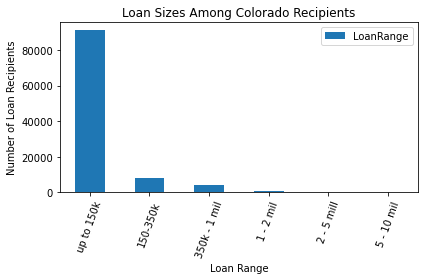

In [14]:
loan_ranges_df = pd.DataFrame(loans.LoanRange.value_counts())
plt.figure(figsize=(4, 6))
loan_ranges_df.plot(kind='bar',
                    title='Loan Sizes Among Colorado Recipients',
                    rot=70)
plt.ylabel('Number of Loan Recipients')
plt.xlabel('Loan Range')
plt.xticks([0, 1, 2, 3, 4, 5], [
    'up to 150k', '150-350k', '350k - 1 mil', '1 - 2 mil', '2 - 5 mill',
    '5 - 10 mil'
])
plt.tight_layout()
plt.savefig('../reports/figures/loan_size_distribution', dpi=300)

In [15]:
loan_ranges_df / loan_ranges_df.sum()

,LoanRange
"f $1-$150,000",0.872589
"e $150,000-350,000",0.075306
"d $350,000-1 million",0.037543
c $1-2 million,0.009462
b $2-5 million,0.004190
a $5-10 million,0.000911


## Who is getting the largest loans?

<Figure size 432x576 with 0 Axes>

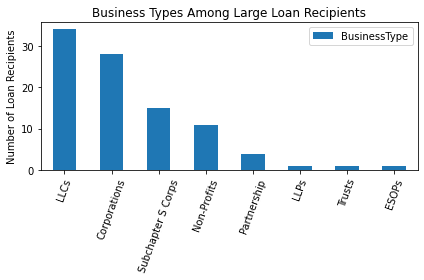

In [16]:
loan_ranges_df = pd.DataFrame(loans[loans['LoanRange'] == 'a $5-10 million']
                              ['BusinessType'].value_counts())
plt.figure(figsize=(6, 8))
loan_ranges_df.plot(kind='bar',
                    title='Business Types Among Large Loan Recipients',
                    rot=70)
plt.ylabel('Number of Loan Recipients')

plt.xticks([0, 1, 2, 3, 4, 5, 6, 7], [
    'LLCs', 'Corporations', 'Subchapter S Corps', 'Non-Profits', 'Partnership',
    'LLPs', 'Trusts', 'ESOPs'
])
plt.tight_layout()
plt.savefig('../reports/figures/large_loans_business_types', dpi=300)

In [17]:
#instantiate the map focused on denver metro but with statewide view
m = folium.Map(location=[38.75, -105.1420], zoom_start=7)

loc = 'Recipients of Largest Loans (5-10 Million) in Colorado'
title_html = '''
             <h3 align="center" style="font-size:24px"><b>{}</b></h3>
             '''.format(loc)

m.get_root().html.add_child(folium.Element(title_html))

# use a clustered view of markers
marker_cluster_bigloans = MarkerCluster(name='Large Loan Recipients',
                                        options={
                                            'disableClusteringAtZoom': 14
                                        }).add_to(m)

df = loans[loans['LoanRange'] == 'a $5-10 million']

for each in df.iterrows():
    folium.Marker([each[1]['latitude'], each[1]['longitude']],
                  popup=str(each[1]['BusinessName'].title() + '\n\nType: ' +
                            each[1]['BusinessType'] + '\n\nJobs Retained: ' +
                            str(each[1]['JobsRetained']) +
                            '\n\nDate Approved: ' + each[1]['DateApproved']),
                  clustered_marker=True,
                  show=True).add_to(marker_cluster_bigloans)

# for each in hc_df[hc_df['MEDICAID'] == "N"].iterrows():
#     folium.Marker(
#         [each[1]['Latitude'], each[1]['Longitude']],
#         popup=str(each[1]['FAC_NAME'] + '\nPhone: ' + each[1]['PHONE'] +
#                   '\nMedicaidAccept: ' + each[1]['MEDICAID']),
#         clustered_marker=True).add_to(marker_cluster_non_medicaid)

#add layer toggle
folium.LayerControl().add_to(m)
html_string = m.get_root().render()
with open("../reports/figures/large_loan_map.html", "w") as text_file:
    print(html_string, file=text_file)
m

## Who is getting the smallest loans?

8.934118188441923


Limited  Liability Company(LLC)    0.319240
Sole Proprietorship                0.255929
Subchapter S Corporation           0.121794
Corporation                        0.121687
Self-Employed Individuals          0.081125
Independent Contractors            0.070930
Non-Profit Organization            0.015452
Partnership                        0.008263
Limited Liability Partnership      0.003219
Professional Association           0.001502
Joint Venture                      0.000322
unknown                            0.000215
Tenant in Common                   0.000107
Trust                              0.000107
Non-Profit Childcare Center        0.000107
Name: BusinessType, dtype: float64

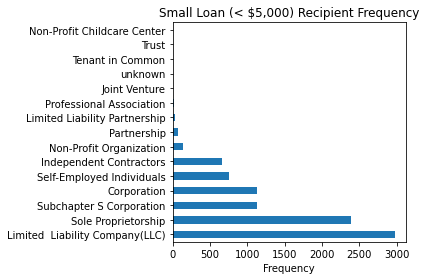

In [18]:
small_df = small_loans[
    small_loans['LoanAmount'] < 5000]['BusinessType'].value_counts()
small_df.plot(
    kind='barh',
    title='Small Loan (< $5,000) Recipient Frequency',
)
plt.xlabel('Frequency')
plt.savefig('../reports/figures/small_loans_by_business_type', dpi=300)
print(small_df.sum() / loans.shape[0] * 100)
small_df / small_df.sum()

In [19]:
#instantiate the map focused on denver metro but with statewide view
m = folium.Map(location=[38.75, -105.1420], zoom_start=7)

loc = 'Identifiable Recipients of PPP Loans In Colorado'
title_html = '''
             <h3 align="center" style="font-size:24px"><b>{}</b></h3>
             '''.format(loc)

m.get_root().html.add_child(folium.Element(title_html))

# use a clustered view of markers
marker_cluster_a = MarkerCluster(name='$5-$10 Million Recipients',
                                 options={
                                     'disableClusteringAtZoom': 14
                                 }).add_to(m)
marker_cluster_b = MarkerCluster(name='$2-$5 Million Recipients',
                                 options={
                                     'disableClusteringAtZoom': 14
                                 },
                                 show=False).add_to(m)

marker_cluster_c = MarkerCluster(name='$1-$2 Million Recipients',
                                 options={
                                     'disableClusteringAtZoom': 14
                                 },
                                 show=False).add_to(m)

marker_cluster_d = MarkerCluster(name='$350k-$1 Million Recipients',
                                 options={
                                     'disableClusteringAtZoom': 14
                                 },
                                 show=False).add_to(m)

marker_cluster_e = MarkerCluster(name='$150k-$350k Recipients',
                                 options={
                                     'disableClusteringAtZoom': 14
                                 },
                                 show=False).add_to(m)

df = loans[loans['LoanRange'] == 'a $5-10 million']

for each in df.iterrows():

    html = '''<body style="background-color:white;"><p style="color:black;">{name}</p>
    <small>Type: {ty}<br>Jobs Retained: {jr}<br>Date Approved: {d}<br></small></body>'''.format(
        name=each[1]['BusinessName'],
        ty=each[1]['BusinessType'],
        jr=each[1]['JobsRetained'],
        d=each[1]['DateApproved'])

    iframe = folium.IFrame(html, width=200, height=120)

    popup = folium.Popup(iframe)
    folium.Marker([each[1]['latitude'], each[1]['longitude']],
                  icon=folium.Icon(color='orange', icon='circle', prefix='fa'),
                  popup=popup,
                  clustered_marker=True,
                  show=True).add_to(marker_cluster_a)

df = loans[loans['LoanRange'] == 'b $2-5 million']

for each in df.iterrows():

    html = '''<body style="background-color:white;"><p style="color:black;">{name}</p>
    <small>Type: {ty}<br>Jobs Retained: {jr}<br>Date Approved: {d}<br></small></body>'''.format(
        name=each[1]['BusinessName'],
        ty=each[1]['BusinessType'],
        jr=each[1]['JobsRetained'],
        d=each[1]['DateApproved'])

    iframe = folium.IFrame(html, width=200, height=120)

    popup = folium.Popup(iframe)
    folium.Marker([each[1]['latitude'], each[1]['longitude']],
                  icon=folium.Icon(color='black', icon='circle', prefix='fa'),
                  popup=popup,
                  clustered_marker=True,
                  show=True).add_to(marker_cluster_b)

df = loans[loans['LoanRange'] == 'c $1-2 million']

for each in df.iterrows():

    html = '''<body style="background-color:white;"><p style="color:black;">{name}</p>
    <small>Type: {ty}<br>Jobs Retained: {jr}<br>Date Approved: {d}<br></small></body>'''.format(
        name=each[1]['BusinessName'],
        ty=each[1]['BusinessType'],
        jr=each[1]['JobsRetained'],
        d=each[1]['DateApproved'])

    iframe = folium.IFrame(html, width=200, height=120)

    popup = folium.Popup(iframe)
    folium.Marker([each[1]['latitude'], each[1]['longitude']],
                  icon=folium.Icon(color='purple', icon='circle', prefix='fa'),
                  popup=popup,
                  clustered_marker=True,
                  show=True).add_to(marker_cluster_c)

df = loans[loans['LoanRange'] == 'd $350,000-1 million']

for each in df.iterrows():

    html = '''<body style="background-color:white;"><p style="color:black;">{name}</p>
    <small>Type: {ty}<br>Jobs Retained: {jr}<br>Date Approved: {d}<br></small></body>'''.format(
        name=each[1]['BusinessName'],
        ty=each[1]['BusinessType'],
        jr=each[1]['JobsRetained'],
        d=each[1]['DateApproved'])

    iframe = folium.IFrame(html, width=200, height=120)

    popup = folium.Popup(iframe)
    folium.Marker([each[1]['latitude'], each[1]['longitude']],
                  icon=folium.Icon(color='red', icon='circle', prefix='fa'),
                  popup=popup,
                  clustered_marker=True,
                  show=True).add_to(marker_cluster_d)

df = loans[loans['LoanRange'] == 'e $150,000-350,000']

for each in df.iterrows():

    html = '''<body style="background-color:white;"><p style="color:black;">{name}</p>
    <small>Type: {ty}<br>Jobs Retained: {jr}<br>Date Approved: {d}<br></small></body>'''.format(
        name=each[1]['BusinessName'],
        ty=each[1]['BusinessType'],
        jr=each[1]['JobsRetained'],
        d=each[1]['DateApproved'])

    iframe = folium.IFrame(html, width=200, height=120)

    popup = folium.Popup(iframe)
    folium.Marker([each[1]['latitude'], each[1]['longitude']],
                  icon=folium.Icon(color='green', icon='circle', prefix='fa'),
                  popup=popup,
                  clustered_marker=True,
                  show=True).add_to(marker_cluster_e)

#add layer toggle
folium.LayerControl('topright', collapsed=False).add_to(m)
html_string = m.get_root().render()
with open("../reports/figures/loan_map.html", "w") as text_file:
    print(html_string, file=text_file)
m

## What do loan amounts look like when broken out by type of business?


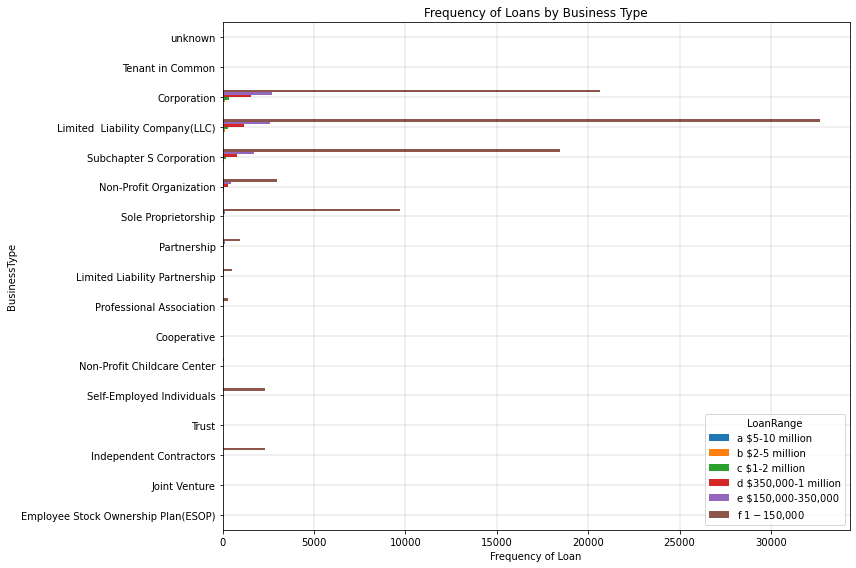

In [20]:
temp_df = pd.pivot_table(loans,
                         index='BusinessType',
                         columns='LoanRange',
                         aggfunc='size').sort_values(by='e $150,000-350,000',
                                                     ascending=True)
temp_df.plot(kind='barh',
             figsize=(12, 8),
             title='Frequency of Loans by Business Type')
plt.xlabel('Frequency of Loan')
plt.grid(color='k', linestyle='-', linewidth=0.3, which='Major', alpha=0.4)
plt.savefig('../reports/figures/loans_by_business_type_frequency', dpi=700)

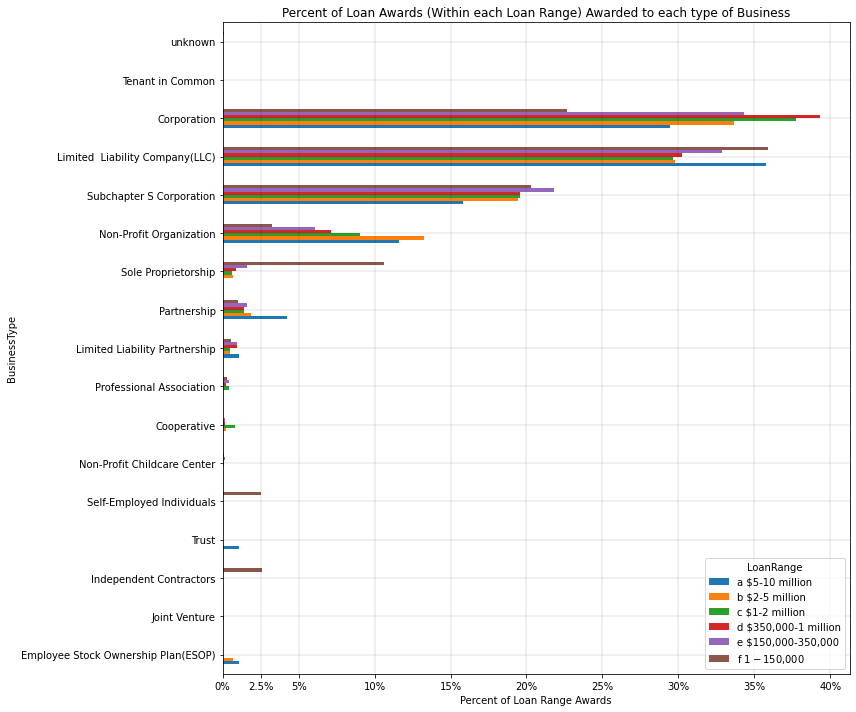

In [21]:
for col in temp_df.columns.to_list():
    temp_df[col] = temp_df[col] / temp_df[col].sum()

temp_df.plot(
    kind='barh',
    figsize=(12, 10),
    title=
    'Percent of Loan Awards (Within each Loan Range) Awarded to each type of Business'
)
plt.xlabel('Percent of Loan Range Awards')
plt.xticks(
    [0, 0.025, 0.05, 0.1, 0.15, 0.2, 0.25, 0.30, 0.35, 0.4],
    ['0%', '2.5%', '5%', '10%', '15%', '20%', '25%', '30%', '35%', '40%'])
plt.grid(color='k', linestyle='-', linewidth=0.3, which='Major', alpha=0.4)
plt.savefig('../reports/figures/loans_by_business_type_percentage', dpi=600)

## What does the breakout of business types by loan groups?


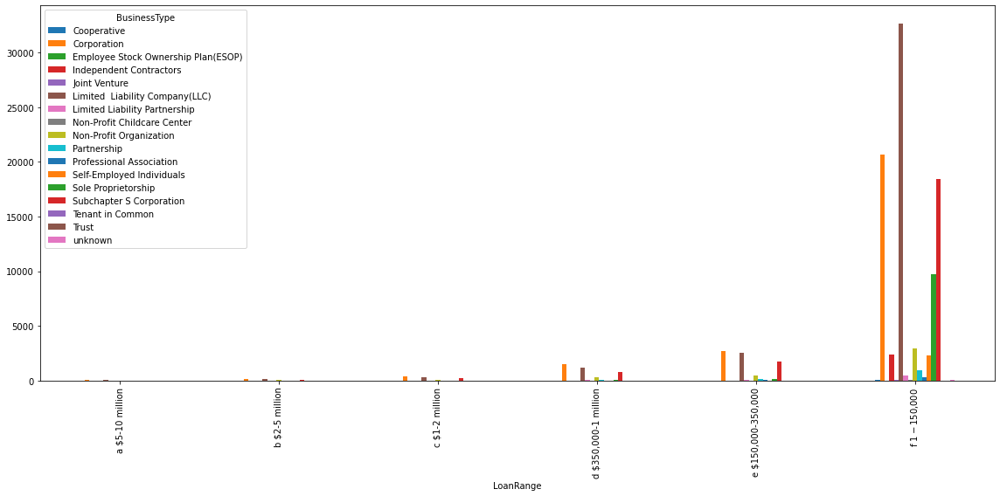

In [22]:
#too busy
temp_df = pd.pivot_table(loans,
                         index='LoanRange',
                         columns='BusinessType',
                         aggfunc='size')
temp_df.plot(kind='bar', figsize=(16, 8))

## Whats the balance of loan awards between nonprofits and for-profit businesses?

,nonprofit_category
For-Profit,100335
Non-Profit,3878
unknown,69


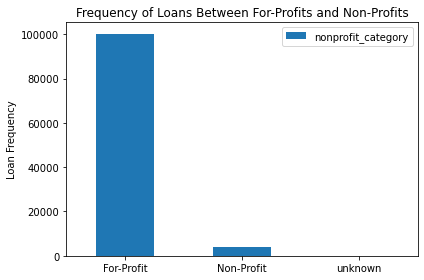

In [23]:
types = loans['BusinessType'].replace([
    'Limited  Liability Company(LLC)', 'Corporation',
    'Subchapter S Corporation', 'Partnership',
    'Employee Stock Ownership Plan(ESOP)', 'Limited Liability Partnership',
    'Trust', 'Sole Proprietorship', 'Cooperative',
    'Non-Profit Childcare Center', 'Professional Association', 'Joint Venture',
    'Self-Employed Individuals', 'Independent Contractors', 'Tenant in Common'
], 'For-Profit')
types = types.replace('Non-Profit Organization', 'Non-Profit')
loans['nonprofit_category'] = types

np_balance = pd.DataFrame(loans.nonprofit_category.value_counts())
np_balance.plot(kind='bar',
                title='Frequency of Loans Between For-Profits and Non-Profits',
                rot=0)
plt.ylabel('Loan Frequency')
plt.savefig('../reports/figures/for_vs_nonprofit_balance', dpi=300)
np_balance

In [24]:
loans.LoanRange.unique()

array(['a $5-10 million', 'b $2-5 million', 'c $1-2 million',
       'd $350,000-1 million', 'e $150,000-350,000', 'f $1-$150,000'],
      dtype=object)

In [25]:
def floor_loan_est(s):
    if s['BusinessType'] != 'Non-Profit Organization':
        if s['LoanRange'] == 'a $5-10 million':
            return 5000000
        elif s['LoanRange'] == 'b $2-5 million':
            return 2000000
        elif s['LoanRange'] == 'c $1-2 million':
            return 1000000
        elif s['LoanRange'] == 'd $350,000-1 million':
            return 350000
        elif s['LoanRange'] == 'e $150,000-350,000':
              return 150000
        elif s['LoanRange'] == 'f $1-$150,000':
            return s['LoanAmount']
        else:
            return np.nan
    elif s['BusinessType'] == 'Non-Profit Organization':
        if s['LoanRange'] == 'a $5-10 million':
            return 10000000
        elif s['LoanRange'] == 'b $2-5 million':
            return 5000000
        elif s['LoanRange'] == 'c $1-2 million':
            return 2000000
        elif s['LoanRange'] == 'd $350,000-1 million':
            return 1000000
        elif s['LoanRange'] == 'e $150,000-350,000':
              return 350000
        elif s['LoanRange'] == 'f $1-$150,000':
            return s['LoanAmount']

    else:
        return np.nan

loans['loan_hypothetical'] = loans.apply(floor_loan_est, axis=1)


In [26]:
loans[['LoanRange','LoanAmount','loan_hypothetical','BusinessType']].head(30)

,LoanRange,LoanAmount,loan_hypothetical,BusinessType
0,a $5-10 million,NaN,5000000.0,Limited Liability Company(LLC)
1,a $5-10 million,NaN,5000000.0,Limited Liability Company(LLC)
2,a $5-10 million,NaN,5000000.0,Corporation
3,a $5-10 million,NaN,5000000.0,Corporation
4,a $5-10 million,NaN,5000000.0,Corporation
5,a $5-10 million,NaN,10000000.0,Non-Profit Organization
6,a $5-10 million,NaN,5000000.0,Limited Liability Company(LLC)
7,a $5-10 million,NaN,5000000.0,Corporation
8,a $5-10 million,NaN,5000000.0,Corporation
9,a $5-10 million,NaN,5000000.0,Corporation


                    loan_hypothetical
nonprofit_category                   
For-Profit               7.344837e+09
Non-Profit               1.148277e+09
unknown                  2.999593e+06


loan_hypothetical    6.396399
dtype: float64

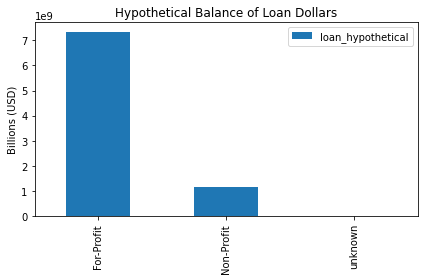

In [27]:
temp_df = pd.pivot_table(loans[['nonprofit_category', 'loan_hypothetical']],
                         index='nonprofit_category',
                         values='loan_hypothetical',
                         aggfunc='sum')
temp_df.plot(kind='bar')
plt.xlabel('')
plt.ylabel('Billions (USD)')
plt.title('Hypothetical Balance of Loan Dollars')
plt.savefig('../reports/figures/nonprofit_best_case_business_worst_case',
            dpi=300)
print(temp_df)
temp_df.iloc[0] / temp_df.iloc[1]

## How many jobs are recipients able to protect in this state?

In [28]:
print(
    'Among all recipients in Colorado, there are {j} staff whose incomes may be supported through this program.'
    .format(j=int(loans.JobsRetained.sum())))

Among all recipients in Colorado, there are 928315 staff whose incomes may be supported through this program.


98.27 % of businesses reported <100 jobs protected


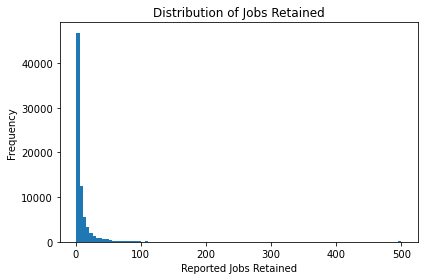

In [29]:
loans[loans['JobsRetained'] > 0]['JobsRetained'].plot(kind='hist', bins=100)
plt.xlabel('Reported Jobs Retained')
plt.title('Distribution of Jobs Retained')
plt.savefig('../reports/figures/jobs_retained_distribution', dpi=300)

print(
    round(
        len(loans[(loans['JobsRetained'] < 100) & (loans['JobsRetained'] > 0)])
        / len(loans[(loans['JobsRetained'] > 0)]) * 100, 2),
    '% of businesses reported <100 jobs protected')

plt.savefig('../reports/figures/jobs_retained_hist', dpi=300)

In [30]:
temp_df = loans[(loans['JobsRetained'] > 100)
                & (loans['LoanRange'] == 'a $5-10 million') &
                (loans['BusinessType'] != 'Non-Profit Organization')][[
                    'BusinessName', 'City', 'BusinessType', 'JobsRetained', 'latitude','longitude'
                ]]
[x.title() for x in temp_df.BusinessName.unique()]

['1888 Industrial Services Llc',
 '4 Rivers Equipment Llc',
 'Advisors Asset Management, Inc',
 'Alcohol Monitoring Systems Inc.',
 'All Copy Products, Inc.',
 'Alvarado Concepts, Llc',
 'Amazing Care Home Health Servi',
 'Apogee Engineering Llc',
 'Appliance Factory Outlet',
 'Arapahoe Motors, Inc.',
 "Bad Daddy'S International Llc",
 'Bighorn Construction & Reclamation, Llc',
 'Boston Market Corp',
 'Brigade Energy Services, Llc',
 'Carepoint, P.C.',
 'Davis Graham & Stubbs Llp',
 'E2 Optics, Llc',
 'Energy Inspection Services, Llc',
 'Fci Constructors',
 'First Meridian Services, Inc.',
 'Gcses Ii Holdings, Lp',
 'Gerald H. Phipps, Inc.',
 'Golftec Enterprises, Llc',
 'Gores Vitac Holdings',
 'Graebel Companies, Inc.',
 'Group Voyagers, Inc.',
 'Haselden Construction',
 'Inspirato, Llc',
 'Intellisource, Llc',
 'Intrepid Potash, Inc.',
 'K2D Inc',
 'Kona Grill Acquisition, Llc',
 'Lignetic, Inc',
 'Longbow Industries Llc',
 'Mac Acquisition Of New Jersey Llc',
 'Madwire, Llc',
 'Mis

In [31]:
temp_df

,BusinessName,City,BusinessType,JobsRetained,latitude,longitude
0,1888 INDUSTRIAL SERVICES LLC,GREELEY,Limited Liability Company(LLC),250.0,40.424577,-104.689967
1,4 RIVERS EQUIPMENT LLC,GREELEY,Limited Liability Company(LLC),444.0,40.420911,-104.694105
2,"ADVISORS ASSET MANAGEMENT, INC",MONUMENT,Corporation,268.0,39.106559,-104.862068
3,ALCOHOL MONITORING SYSTEMS INC.,LITTLETON,Corporation,270.0,39.573013,-104.986797
4,"ALL COPY PRODUCTS, INC.",DENVER,Corporation,408.0,39.737243,-105.008392
...,...,...,...,...,...,...
87,TRUST-BOSTON MARKET CORP,LAKEWOOD,Trust,500.0,39.7431849,-105.1610792
88,"U.S. TRANSPORT,INC",DENVER,Subchapter S Corporation,277.0,39.7986837,-104.9905102
89,"WARD ELECTRIC COMPANY, INC.",LONGMONT,Subchapter S Corporation,315.0,40.140939,-104.978747
91,"WELLBRIDGE CLUB MANAGEMENT, LLC",GREENWOOD VILLAGE,Limited Liability Company(LLC),500.0,39.605386,-104.89305


In [32]:
#instantiate the map focused on denver metro but with statewide view
m = folium.Map(location=[38.75, -105.1420], zoom_start=7)

loc = '$5-$10 Million Recipients with 100+ staff'
title_html = '''
             <h3 align="center" style="font-size:24px"><b>{}</b></h3>
             '''.format(loc)

m.get_root().html.add_child(folium.Element(title_html))

# use a clustered view of markers
marker_cluster_a = MarkerCluster(name='$5-$10 Million Recipients with 100+ staff',
                                 options={
                                     'disableClusteringAtZoom': 14
                                 }).add_to(m)


for each in temp_df.iterrows():

    html = '''<body style="background-color:white;"><p style="color:black;">{name}</p>
    <small>Type: {ty}<br>Jobs Retained: {jr}<br></small></body>'''.format(
        name=each[1]['BusinessName'],
        ty=each[1]['BusinessType'],
        jr=str(each[1]['JobsRetained']))

    iframe = folium.IFrame(html, width=200, height=120)

    popup = folium.Popup(iframe)
    folium.Marker([each[1]['latitude'], each[1]['longitude']],
                  icon=folium.Icon(color='orange', icon='circle', prefix='fa'),
                  popup=popup,
                  clustered_marker=True,
                  show=True).add_to(marker_cluster_a)

#add layer toggle
folium.LayerControl('topright', collapsed=False).add_to(m)
html_string = m.get_root().render()
with open("../reports/figures/not_so_small_businesses.html", "w") as text_file:
    print(html_string, file=text_file)
m

## What do staff sizes look like when broken out by business types?

<Figure size 1152x576 with 0 Axes>

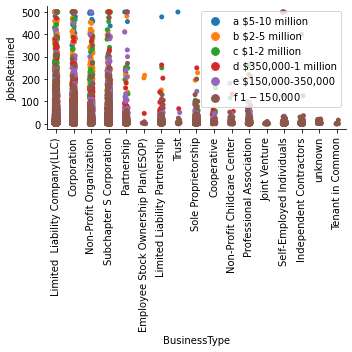

In [33]:
plt.figure(figsize=(16, 8))
sns.catplot(x="BusinessType",
            y="JobsRetained",
            hue="LoanRange",
            data=loans,
            legend=False)
plt.xticks(rotation=90)
# plt.xticks([0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14], [
#     'LLCs', 'Corporations', 'Non-Profit', 'Subchapter S Corps', 'Partnership',
#     'ESOP', 'LLP', 'Trust', 'Sole Proprietorship', 'Coop', 'NP Childcare',
#     'Professional Assoc.', 'Joint venture', 'Self Employed Individual',
#     'Independent Contractor'
# ])
plt.legend(loc='upper right')
plt.savefig('../reports/figures/jobs_retained_by_business_type', dpi=300)

In [34]:
small_loans.describe()

,LoanAmount,Zip,NAICSCode,JobsRetained,dollar_per_job
count,91018.000000,91017.000000,88767.000000,82822.000000,66622.000000
mean,33230.388425,80521.620917,546023.335902,4.458610,9254.221477
std,33262.318653,573.591932,187101.230877,10.939127,6906.686544
min,1.000000,6082.000000,111110.000000,0.000000,0.500000
25%,9838.425000,80134.000000,452111.000000,1.000000,4550.000000
50%,20800.000000,80304.000000,541410.000000,2.000000,7797.000000
75%,45300.000000,80903.000000,621999.000000,5.000000,12445.000000
max,149995.000000,94952.000000,999990.000000,500.000000,139910.000000


In [35]:
small_loans[small_loans['LoanAmount'] <= 50]

,LoanAmount,City,State,Zip,NAICSCode,BusinessType,RaceEthnicity,Gender,Veteran,NonProfit,JobsRetained,DateApproved,Lender,CD,dollar_per_job,LoanRange
91013,46.0,LITTLETON,CO,80128.0,454390.0,Corporation,NaN,NaN,NaN,NaN,0.0,6/11/2020,"Wells Fargo Bank, National Association",CO - 01,NaN,"f $1-$150,000"
91014,44.0,DENVER,CO,80224.0,333318.0,Corporation,NaN,Male Owned,Non-Veteran,NaN,3.0,5/12/2020,"Bank of America, National Association",CO - 01,14.67,"f $1-$150,000"
91015,17.0,CARBONDALE,CO,81623.0,561621.0,Limited Liability Company(LLC),NaN,NaN,NaN,NaN,1.0,4/30/2020,"Bank of America, National Association",CO - 03,17.00,"f $1-$150,000"
91016,4.0,THORNTON,CO,80233.0,NaN,Limited Liability Company(LLC),NaN,NaN,NaN,NaN,3.0,5/3/2020,"Bank of America, National Association",CO - 07,1.33,"f $1-$150,000"
91017,1.0,SILVERTHORNE,CO,80498.0,999990.0,Limited Liability Company(LLC),NaN,NaN,NaN,NaN,2.0,5/3/2020,"Bank of America, National Association",CO - 02,0.50,"f $1-$150,000"


In [36]:
import plotly as py
import plotly.express as px
import plotly.graph_objs as go
from plotly.offline import download_plotlyjs, init_notebook_mode, plot, iplot
init_notebook_mode(connected=True)

In [37]:
fig = px.box(small_loans, x='BusinessType', y='dollar_per_job')
fig.update_layout(title="USD / Job Ratio Across Funded Loans",
                  yaxis_title=" USD/Job Retained",
                  xaxis_title="Business Type")
py.offline.iplot(fig,
                 filename='../../reports/figures/usd_job_ratio_boxplot.html')
fig.write_html('../reports/figures/usd_job_ratio_boxplot.html')

In [38]:
fig = px.scatter(small_loans,
                 x='JobsRetained',
                 y='LoanAmount',
                 color='BusinessType')
fig.update_layout(
    title="Colorado Small ($1-$150k) Loan Amounts vs Job Retainment",
    yaxis_title="Loan Amount ($usd)",
    xaxis_title="Jobs Retained (# of jobs)")
py.offline.iplot(
    fig, filename='../../reports/figures/jobs_vs_loan_amnt_scatter.html')
fig.write_html('../reports/figures/loan_amount_jobs_protected_scatter.html')

## Reflections

What a fun exploration. While it would have been faster for me to use PowerBI (or maybe even excel for some simple plots but we wont talk about that...), I'm trying to practice my programming at least an hour a day and play with different tools.

Some thoughts in no particular order:
* I love plotly's interactive charts, but I wish some of the click events were more clearly laid out for someone just walking up to a random figure.
* I don't quite see why specific loan amounts are private in this dataset... If kind of like civilian science to me: If tax dollars are paying for it, it should be totally transparent for citizens giving up their income to make it happen.
* There are some holdings companies in the large loan, lots of jobs cross section and even one company I interviewed with recently that definitely spoke about growing out of their "small startup stage" They also completely ghosted right at the end of the process and did not reply to follow up emails checking in... Not sure how to feel about that.
* My code to add map layers is redundant. I should probably create a simple function out of that already.
